3. Can we predict electric range based on make, model year, and vehicle type? (Intro to ML)  

In [15]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
# Imported essential libraries for data handling, visualization, and modeling.
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression


# If the file is inside a folder named 'CSV'
df = pd.read_csv(r'C:\Users\ADMIN\Desktop\EV_Data_Analysis\CSV\Electric_Vehicle_Population_Data.csv')

# Select features and target
# More numeric features would have been useful (like battery capacity, weight, etc.) could improve the model if available
features = ['Make', 'Model Year', 'Electric Vehicle Type']
target = 'Electric Range'

# Drop rows with missing target (or input)
df = df.dropna(subset=[target])

In [16]:
# One-hot encoding is good, as it drop_first=True avoids the dummy variable trap.
X = pd.get_dummies(df[features], drop_first=True)
y = df[target]

# Train-test split (Classic 80% training, 20% test); using random_state for reproducibility.
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [17]:
# Training model - Linear regression model fits successfully.
# Fit model
model = LinearRegression()
model.fit(X_train, y_train)

# Evaluate performance
r2 = model.score(X_test, y_test)
print(f"R² on test set: {r2:.2f}")

#An R² of 0.37 means your model explains about 37% of the variance in the electric range.
#It’s a decent starting point, but more features or a non-linear model might improve it.

R² on test set: 0.37


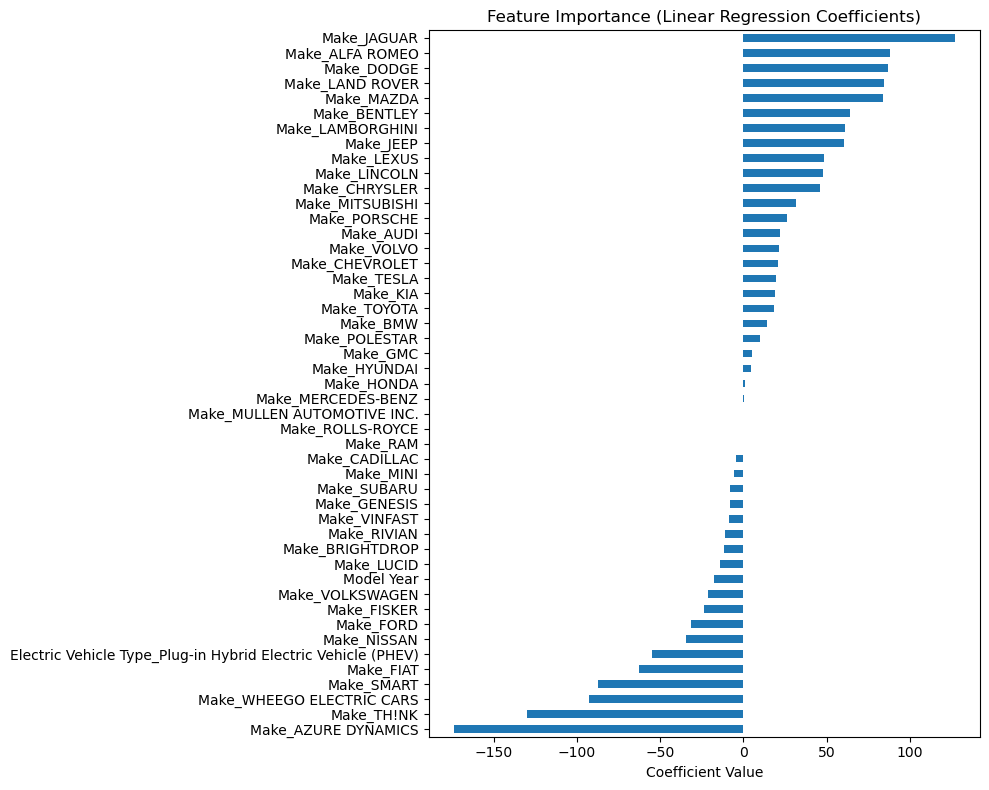

In [18]:
# Feature importance from coefficients
coef_series = pd.Series(model.coef_, index=X.columns).sort_values()

plt.figure(figsize=(10, 8))
coef_series.plot(kind='barh')
plt.title("Feature Importance (Linear Regression Coefficients)")
plt.xlabel("Coefficient Value")
plt.tight_layout()
plt.show()

#The horizontal bar chart (which you provided) clearly shows which makes and features impact electric range.
#Negative values imply negative association (e.g. some makes consistently have lower ranges).


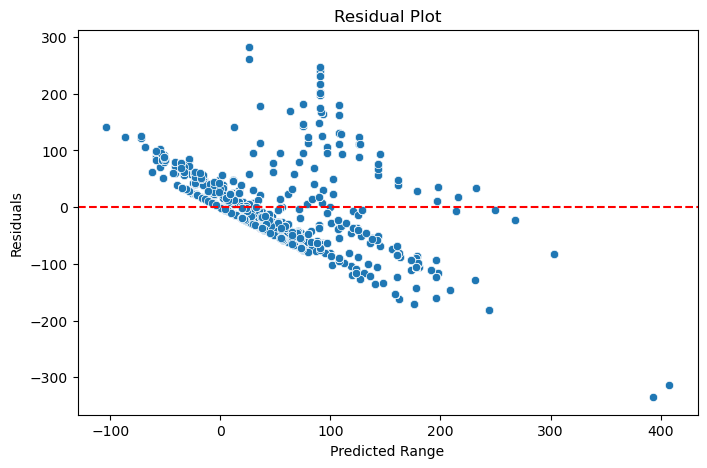

In [19]:
# Predict on test set
y_pred = model.predict(X_test)
residuals = y_test - y_pred

# Residual plot
plt.figure(figsize=(8, 5))
sns.scatterplot(x=y_pred, y=residuals)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel('Predicted Range')
plt.ylabel('Residuals')
plt.title('Residual Plot')
plt.show()
#The funnel shape suggests heteroscedasticity, meaning variance of residuals isn’t constant.
#Might be a sign linear regression isn’t the best model — maybe try Random Forest or XGBoost next.

In [ ]:
#Start
from sklearn.ensemble import RandomForestRegressor

model = RandomForestRegressor(random_state=42)
model.fit(X_train, y_train)
y_pred = model.predict(X_test)


In [11]:
import numpy as np

y_log = np.log1p(df[target])  # log(1 + y) to handle zeroes

# Use y_log instead of y in model training


In [12]:
import scipy.stats as stats

z_scores = np.abs(stats.zscore(y))
df_clean = df[z_scores < 3]  # Keep rows with z-score < 3

In [ ]:
from sklearn.preprocessing import PolynomialFeatures

poly = PolynomialFeatures(degree=2, include_bias=False)
X_poly = poly.fit_transform(X)  # do this before train_test_split
# End


In [20]:
import plotly.express as px

px.scatter(df, x='Model Year', y='Electric Range', color='Make',
           title='Range vs. Year by Make',
           hover_data=['Model', 'Electric Vehicle Type'])
